In [45]:
# Import initial necessary libraries
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import scipy.stats as st
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

# Settings of dataframe display
pd.options.display.max_columns = 100
pd.options.display.max_colwidth = None

# Version requirements
print('numpy version : ',np.__version__)
print('pandas version : ',pd.__version__)
print('seaborn version : ',sns.__version__)

numpy version :  1.26.4
pandas version :  2.2.1
seaborn version :  0.13.2


## Load Dataset

In [46]:
df = pd.read_excel("DatabaseSHnP_paperICGERE.xlsx")

In [47]:
df.sample(10)

,Thickness,Area,OilDensity,InjRate,InjTemp,Permeability,kVkH,Porosity,Pressure,Sw,Temperature,Xsteam,Swcon,Sorw,Sgcon,Sorg,Krocw,Krwiro,Krgcl,NW,NOW,NG,NOG,ViscA,ViscB,InjectionPeriod,SoakingPeriod,ProductionPeriod,InjProdPeriodRatio,InjSoakProdRatio,InjTime,SoakTime,ProdTime,Np,Qomax,Qo_End,P_End,T_End,Sw_End,So_End,RFOil,OilVolumeSC,OilVolumeSC_End,OilVolumeRC,OilVolumeRC_End,OilVolumeRC_Max,HCPV_Init,HCPV_Max,OilSteamRatio,Wp,Qwmax,Wi,Qw_End,P_StartProd,Pwf_StartProd,T_StartProd,NearWell_T_End,NearWell_P_End,NearWell_T_StartProd,NearWell_P_StartProd,NearWell_So_End,NearWell_So_StartProd,OilVisEnd,MinOilVis,PV_init,PV_end,PV_Max,tQomax,StartProd,OilStartProd,MinOilVisTime,tQomax_cycle,Lp,LnLp,LnOilStartProd,LnNp,LnQomax,LnQoEnd,LnTQomax,LntQoMax_Cycle,OilStart_cycle,LnOilStart_cycle,tQomax_fromOilStart,LntQomax_fromOilStart,LnOilSteamRatio,LnWp,LnQwmax,LnWi,LnOilVisEnd,OilVolumeChange,HCPVChange,PVChange
1036,51.981529,7.5,61.136262,648.05832,330.51641,2619.34000,0.106825,0.286633,771.85990,0.331926,67.610642,0.695426,0.360679,0.194157,0.075210,0.007698,0.366772,0.614845,0.962914,4,1,4,3,0.000549,4817.2302,17,28,240,0.070833,0.187500,17,45,285,1847.48390,13.498368,6.812622,776.065000,67.605682,0.332438,0.667562,0.235485,784544.38,782697.19,4400772.0,4390490.5,4400781.5,4400772.0,4400781.5,133.966430,30.754524,0.328548,13.790650,0.031107,780.19373,775.85071,67.616364,67.781708,573.688540,68.387970,786.43359,0.640059,0.668480,7673.529800,7670.967800,6587256.0,6576905.5,6587344.0,45.999988,45.000000,45.000000,17.000002,1,1878.2384,7.538,3.81,7.522,2.603,1.919,3.83,0.00,0.0,0.00,1.0,0.00,4.90,3.426,-1.113,2.624,8.946,9.5,9.5,88.0
1888,91.517576,3.0,61.917688,740.21321,383.29261,4778.17680,0.137887,0.317139,483.79864,0.080572,67.278621,0.900276,0.375411,0.164684,0.045810,0.173360,0.347639,0.282036,0.981290,1,2,3,3,0.000918,4217.3090,12,9,180,0.066667,0.116667,12,21,201,29783.10900,1190.068100,85.068367,421.680110,67.984589,0.086973,0.913027,3.954910,753066.63,723241.13,4229620.5,4064459.0,4232584.5,4229620.5,4237611.0,6.888077,1390.495400,876.953310,4323.864700,0.000000,516.21753,689.98975,70.832855,109.134550,176.363080,486.916990,706.06262,0.670655,0.437533,1645.991200,1638.001100,4600275.5,4451629.0,4635602.0,22.999990,21.000002,21.000002,21.000002,2,31173.6040,10.347,3.04,10.302,7.082,4.443,3.14,0.69,0.0,0.00,2.0,0.69,1.93,7.237,6.776,8.372,7.406,2964.0,7990.5,35326.5
1801,72.608979,2.5,59.119555,616.01903,409.97812,686.74180,0.132045,0.290213,528.83502,0.148021,109.287840,0.847267,0.242744,0.145996,0.014486,0.198877,0.992571,0.377232,0.309684,2,3,2,2,0.000678,4750.2813,28,10,360,0.077778,0.105556,28,38,398,24124.51600,842.567630,29.572268,444.604490,111.897490,0.162466,0.837534,5.707737,422663.38,398461.75,2411603.3,2276481.0,2416834.5,2411603.3,2431769.3,2.861625,4558.181600,1206.265100,8430.354500,0.000000,607.65240,1050.46750,119.426970,178.708340,153.248980,550.693360,1050.52150,0.769731,0.309299,2192.809800,2192.304000,2830590.0,2718075.0,2904161.0,39.999988,38.000000,38.000000,314.969670,2,28682.6980,10.264,3.64,10.091,6.736,3.387,3.69,0.69,0.0,0.00,2.0,0.69,1.05,8.425,7.095,9.040,7.693,5231.2,20166.0,73571.0
5363,46.761340,6.0,61.263241,618.16853,356.32290,2383.19960,0.204204,0.320086,550.11138,0.304597,110.366220,0.870894,0.191205,0.337794,0.095294,0.013426,0.921336,0.763528,0.686414,1,1,4,1,0.000941,4357.8466,11,21,60,0.183333,0.533333,11,32,92,761.68970,39.443542,38.396000,265.007900,109.859650,0.211946,0.788054,0.128673,591958.13,591033.06,3378640.3,3377646.8,3382720.5,3378640.3,3409128.8,0.112023,108012.510000,2001.144500,6799.404300,817.554690,581.04950,574.57440,114.789460,111.368870,189.505780,453.022520,583.30701,0.802633,0.116232,907.401310,872.578670,4858539.0,4286059.5,4929488.5,87.999988,32.000000,32.500000,15.000001,56,108774.2000,11.597,3.48,6.636,3.675,3.648,4.48,4.03,0.5,0.00,55.5,4.02,-2.19,11.590,7.601,8.825,6.811,4080.2,30488.5,70949.5
1124,57.781125,7.5,61.219581,677.60408,353.81659,2506.85670,0.2

In [48]:
df.columns

Index(['Thickness', 'Area', 'OilDensity', 'InjRate', 'InjTemp', 'Permeability',
       'kVkH', 'Porosity', 'Pressure', 'Sw', 'Temperature', 'Xsteam', 'Swcon',
       'Sorw', 'Sgcon', 'Sorg', 'Krocw', 'Krwiro', 'Krgcl', 'NW', 'NOW', 'NG',
       'NOG', 'ViscA', 'ViscB', 'InjectionPeriod', 'SoakingPeriod',
       'ProductionPeriod', 'InjProdPeriodRatio', 'InjSoakProdRatio', 'InjTime',
       'SoakTime', 'ProdTime', 'Np', 'Qomax', 'Qo_End', 'P_End', 'T_End',
       'Sw_End', 'So_End', 'RFOil', 'OilVolumeSC', 'OilVolumeSC_End',
       'OilVolumeRC', 'OilVolumeRC_End', 'OilVolumeRC_Max', 'HCPV_Init',
       'HCPV_Max', 'OilSteamRatio', 'Wp', 'Qwmax', 'Wi', 'Qw_End',
       'P_StartProd', 'Pwf_StartProd', 'T_StartProd', 'NearWell_T_End',
       'NearWell_P_End', 'NearWell_T_StartProd', 'NearWell_P_StartProd',
       'NearWell_So_End', 'NearWell_So_StartProd', 'OilVisEnd', 'MinOilVis',
       'PV_init', 'PV_end', 'PV_Max', 'tQomax', 'StartProd', 'OilStartProd',
       'MinOilVisTime', 'tQomax

In [49]:
# Separate feature and target columns
all_columns = ['Thickness', 'Area', 'OilDensity', 'InjRate', 'InjTemp', 'Permeability',
               'kVkH', 'Porosity', 'Pressure', 'Sw', 'Temperature', 'Xsteam', 'Swcon',
               'Sorw', 'Sgcon', 'Sorg', 'Krocw', 'Krwiro', 'Krgcl', 'NW', 'NOW', 'NG',
               'NOG', 'ViscA', 'ViscB', 'InjectionPeriod', 'SoakingPeriod', 'ProductionPeriod', 'InjProdPeriodRatio',
               'InjSoakProdRatio', 'Qo_End', 'RFOil', 'OilSteamRatio']

feature_columns = ['Thickness', 'Area', 'OilDensity', 'InjRate', 'InjTemp', 'Permeability',
                   'kVkH', 'Porosity', 'Pressure', 'Sw', 'Temperature', 'Xsteam', 'Swcon',
                   'Sorw', 'Sgcon', 'Sorg', 'Krocw', 'Krwiro', 'Krgcl', 'NW', 'NOW', 'NG',
                   'NOG', 'ViscA', 'ViscB']

target_columns = ['InjectionPeriod', 'SoakingPeriod', 'ProductionPeriod', 'InjProdPeriodRatio',
                  'InjSoakProdRatio', 'Qo_End', 'RFOil', 'OilSteamRatio']

In [50]:
# Filter the columns for EDA process
df = df[all_columns]

### Additional Information About Multi Output Regression

Yes, you can use multiple target features in a regression problem. This is known as multi-output regression. Below is an example of how you can split the dataset into training and testing sets and build a regression model using Python's `scikit-learn`.

Here is an example using `LinearRegression` from `scikit-learn`:

```python
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

# Assuming you have a DataFrame named `df` with the necessary columns
df = pd.read_csv('your_dataset.csv')  # Replace with your dataset

# Define feature and target columns
selected_feature_columns = ['Thickness', 'Area', 'OilDensity', 'InjRate', 'InjTemp', 'Permeability',
                            'kVkH', 'Porosity', 'Pressure', 'Sw', 'Temperature', 'Xsteam', 'Swcon',
                            'Sorw', 'Sgcon', 'Sorg', 'Krocw', 'Krwiro', 'Krgcl', 'NW', 'NOW', 'NG',
                            'NOG', 'ViscA', 'ViscB']
selected_target_columns = ['InjectionPeriod', 'SoakingPeriod', 'ProductionPeriod', 'InjProdPeriodRatio',
                           'InjSoakProdRatio', 'Qo_End', 'RFOil', 'OilSteamRatio']

# Split data into features and targets
X = df[selected_feature_columns]
y = df[selected_target_columns]

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create and train the model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred, multioutput='raw_values')
r2 = r2_score(y_test, y_pred, multioutput='variance_weighted')

print("Mean Squared Error for each target:", mse)
print("R^2 Score:", r2)
```

In this example:
1. We load the dataset into a DataFrame.
2. Define the feature and target columns.
3. Split the data into training and testing sets.
4. Train a linear regression model on the training data.
5. Make predictions on the test data.
6. Evaluate the model using Mean Squared Error (MSE) and R-squared (R²) score.

You can replace `LinearRegression` with any other regression model from `scikit-learn` or other libraries that support multi-output regression.

In [51]:
# # Re-arrange column (target at the end --> personal preference)
# df_1 = df.drop(columns='RFOil')
# df_2 = df['RFOil']
# df = pd.concat([df_1, df_2], axis='columns')

In [52]:
# Checking shape of dataframe
print(f'Number of rows: {df.shape[0]}')
print(f'Number of columns {df.shape[1]}')

Number of rows: 5949
Number of columns 33


In [53]:
# Dataset overview
desc_col = []

for col in df.columns :
    desc_col.append([col, df[col].dtype, df[col].isna().sum(), round(df[col].isna().sum()/len(df) * 100, 2), df.duplicated().sum(), df[col].nunique(), df[col].unique()[:5]])

desc_df = pd.DataFrame(data=desc_col, columns='Feature, Data Type, Null Values, Null Percentage (%), Duplicated Values, Unique Values, 5 Unique Sample'.split(","))
desc_df

,Feature,Data Type,Null Values,Null Percentage (%),Duplicated Values,Unique Values,5 Unique Sample
0,Thickness,float64,0,0.0,0,5949,"[39.824628, 65.026244, 40.202023, 71.850387, 36.984783]"
1,Area,float64,0,0.0,0,15,"[1.0, 0.5, 1.5, 2.0, 2.5]"
2,OilDensity,float64,0,0.0,0,5945,"[62.214501, 60.342411, 61.902308, 62.203022, 59.734051]"
3,InjRate,float64,0,0.0,0,5949,"[751.34728, 581.50751, 697.68516, 620.03005, 907.04751]"
4,InjTemp,float64,0,0.0,0,5949,"[462.20765, 305.14547, 356.48412, 449.99169, 276.3777]"
5,Permeability,float64,0,0.0,0,5949,"[832.06533, 2598.0439, 4391.0838, 511.99357, 449.83624]"
6,kVkH,float64,0,0.0,0,5949,"[0.14880892, 0.28294277, 0.25165011, 0.29079958, 0.24742406]"
7,Porosity,float64,0,0.0,0,5946,"[0.30122363, 0.21792915, 0.30894733, 0.30556356, 0.26663825]"
8,Pressure,float64,0,0.0,0,5949,"[581.38029, 523.48885, 286.24688, 427.08838, 342.83004]"
9,Sw,float64,0,0.0,0,5949,"[0.22768525, 0.051366351, 0.085472053, 0.22679004, 0.052585555]"


The dataset has no issues in terms of data type formatting, null values, or duplicated values.

- Numerical (Continuous) columns (26 columns) :

    - `'Thickness', 'Area', 'OilDensity', 'InjRate', 'InjTemp', 'Permeability', 'kVkH', 'Porosity', 'Pressure', 'Sw', 'Temperature', 'Xsteam', 'Swcon', 'Sorw', 'Sgcon', 'Sorg', 'Krocw', 'Krwiro', 'Krgcl', 'ViscA', 'ViscB', 'InjProdPeriodRatio', 'InjSoakProdRatio', 'Qo_End', 'RFOil', 'OilSteamRatio'`

- Numerical (Discrete) columns (7 columns) : (need more context, all of these could be continuous)
    - `'NW', 'NOW', 'NG', 'NOG', 'InjectionPeriod', 'SoakingPeriod', 'ProductionPeriod'`


# **STAGE 1 : EXPLORATORY DATA ANALYSIS (EDA)**

## Statistical Summary

In [54]:
# ?st.variation

In [55]:
# Numerical columns
nums_summary = df.describe().transpose()
nums_summary['range'] = nums_summary['max'] - nums_summary['min']
# nums_summary['var'] = st.variation(df.values)
nums_summary['coefficient of variation'] = (nums_summary['std'] / nums_summary['mean']) * 100

nums_summary

,count,mean,std,min,25%,50%,75%,max,range,coefficient of variation
Thickness,5949.0,59.655512,23.129914,2.003194e+01,39.583709,59.649816,79.486605,99.953139,79.921201,38.772468
Area,5949.0,3.932426,2.186605,5.000000e-01,2.000000,4.000000,6.000000,7.500000,7.000000,55.604496
OilDensity,5949.0,61.034066,1.062648,5.666834e+01,60.308377,61.059831,61.805859,63.299332,6.630993,1.741074
InjRate,5949.0,811.334666,265.155691,2.037951e+02,623.062030,796.963710,996.543540,1496.683600,1292.888520,32.681420
InjTemp,5949.0,368.168357,51.677376,2.534122e+02,330.096570,365.420260,404.482800,499.101850,245.689650,14.036344
Permeability,5949.0,2779.948179,1475.150241,1.017303e+02,1680.854200,2650.241300,3783.772900,8694.562800,8592.832460,53.063947
kVkH,5949.0,0.200710,0.057747,1.000112e-01,0.150946,0.200011,0.252029,0.299960,0.199948,28.771395
Porosity,5949.0,0.306935,0.042116,1.394895e-01,0.278746,0.307892,0.337775,0.399933,0.260444,13.721313
Pressure,5949.0,554.366586,240.568255,1.002665e+02,371.736870,539.099710,715.856590,1492.336000,1392.069450,43.395158
Sw,5949.0,0.343384,0.164541,8.700708e-04,0.223270,0.349038,0.456658,0.861834,0.860964,47.917443


## Univariate Analysis

### Numerical

In [56]:
len(all_columns)

33

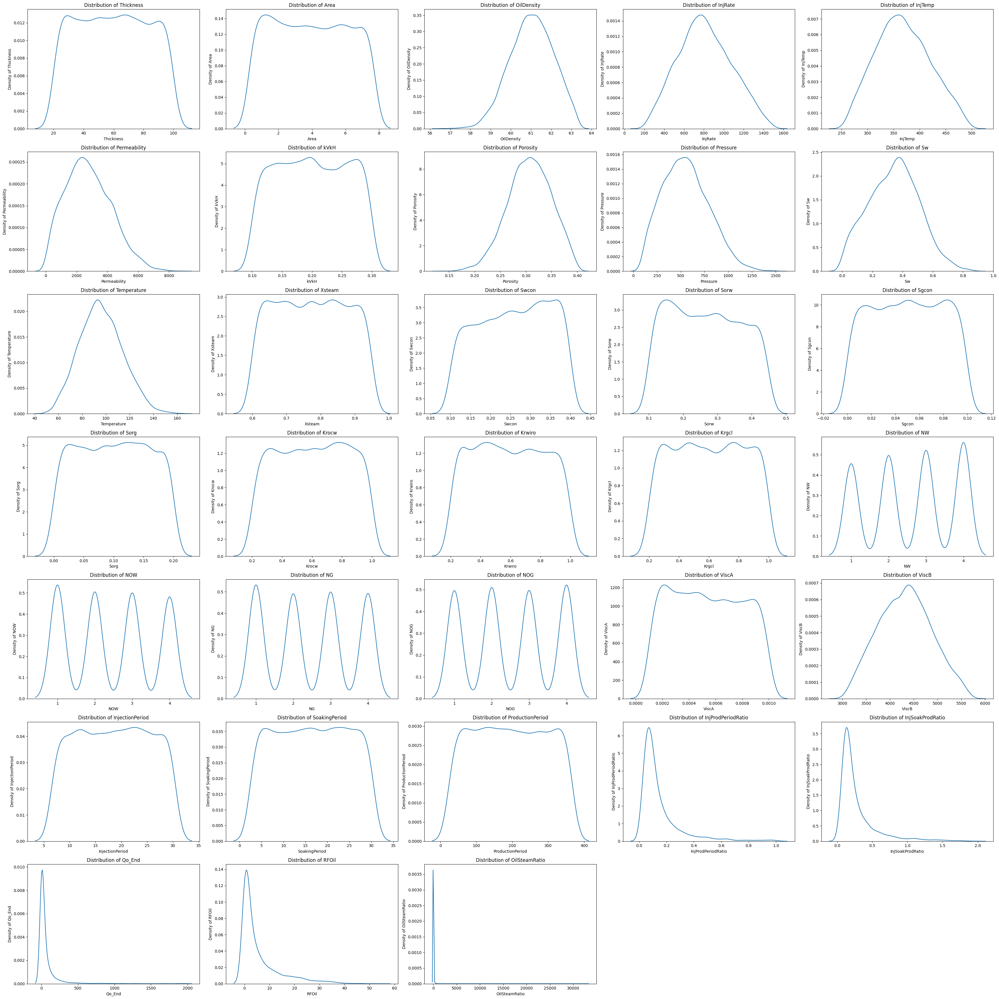

In [57]:
# Kdeplot
fig, ax = plt.subplots(nrows=7, ncols=5, figsize=(35, 35))
ax = ax.flatten()

for i, col in enumerate(all_columns) :
    sns.kdeplot(data=df, x=col, ax=ax[i])
    ax[i].set_title(f'Distribution of {col}')
    ax[i].set_ylabel(f'Density of {col}')
    ax[i].set_xlabel(f'{col}')

# Hide the 34th and 35th plots (index 33 and 34)
ax[33].axis('off')
ax[34].axis('off')

plt.tight_layout()
plt.show()

In [58]:
# ?st.probplot

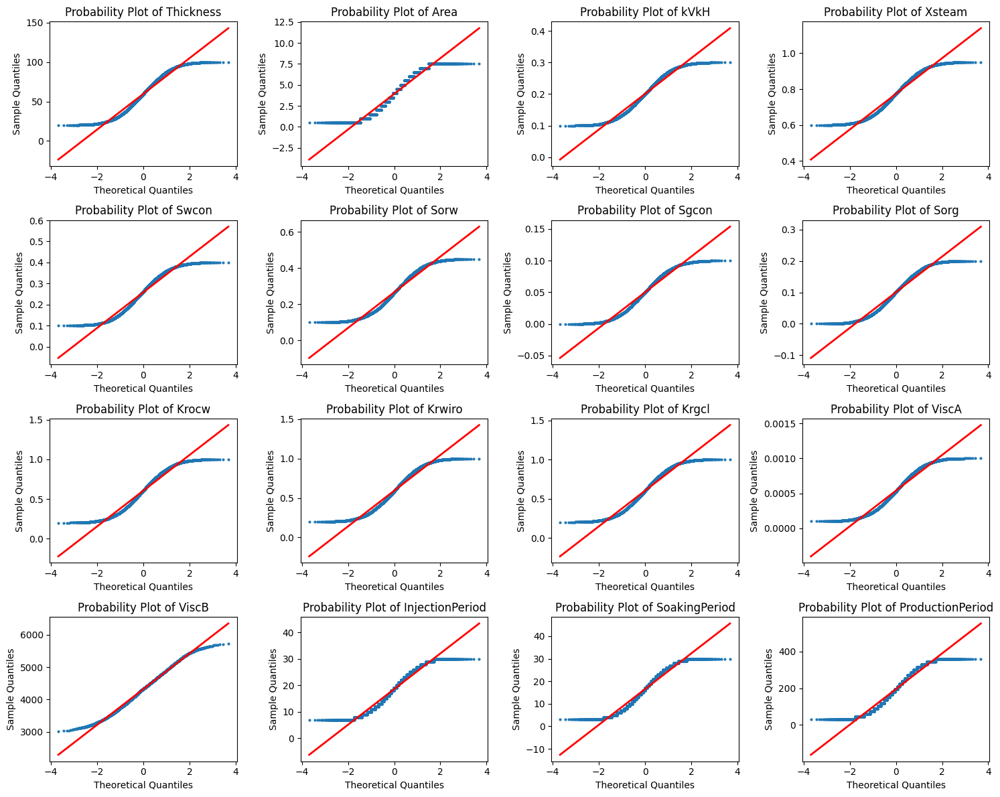

In [59]:
# Quantile-quantile (Q-Q) plot
columns_to_check = ["Thickness", "Area", "kVkH", "Xsteam", "Swcon", "Sorw", "Sgcon", "Sorg",
                    "Krocw", "Krwiro", "Krgcl", "ViscA", "ViscB", "InjectionPeriod", "SoakingPeriod", "ProductionPeriod"]

fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(15, 12))
axes = axes.flatten()

for i, col in enumerate(columns_to_check):
    (osm, osr), (slope, intercept, r) = st.probplot(df[col].values, dist="norm")
    axes[i].plot(osm, osr, 'o', markersize=2)
    axes[i].plot(osm, slope * osm + intercept, 'r', linewidth=2)
    axes[i].set_title(f'Probability Plot of {col}')
    axes[i].set_xlabel('Theoretical Quantiles')
    axes[i].set_ylabel('Sample Quantiles')

plt.tight_layout()
plt.show()


In [60]:
from scipy.stats import skew, kurtosis, kstest
from diptest import diptest

def analyze_distribution(df, all_columns):
    distribution_type_list = []
    skew_val_list = []
    kurtosis_val_list = []
    p_value_ks_list = []
    p_value_dip_list = []
    mean_list = []
    median_list = []
    mode_list = []

    for column in all_columns:
        data = df[column].dropna()

        mean = round(data.mean(), 3)
        median = data.median()
        mode = data.mode().iloc[0]  # Take the first mode if there are multiple

        skew_val = round(skew(data, nan_policy="omit"), 3)
        kurtosis_val = round(kurtosis(data, nan_policy="omit"), 3)

        # Scale data to the range [0, 1]
        data_min, data_max = data.min(), data.max()
        scaled_data = (data - data_min) / (data_max - data_min)

        threshold_pvalue = 0.05

        try:
            # Kolmogorov-Smirnov Test for uniform distribution
            _, p_value_ks = kstest(scaled_data, 'uniform')

            # Perform Dip Test for multimodal distribution
            _, p_value_dip = diptest(data)

            # Determine the type of distribution
            if p_value_dip < threshold_pvalue:
                distribution_type = "Multimodal Distribution"
            elif p_value_ks > threshold_pvalue and abs(kurtosis_val + 1.2) < 0.5:
                distribution_type = "Uniform Distribution"

            elif abs(skew_val) < 0.2 and abs(kurtosis_val) < 0.2:
                distribution_type = "Normal Distribution (Symmetric)"
                
            else:
                # Use mean-median-mode relationship
                if mean < median < mode:
                    distribution_type = "Negatively Skewed"
                elif mean > median > mode:
                    distribution_type = "Positively Skewed"
                else:
                    # Fallback to skewness value if mean-median-mode relationship is inconclusive
                    if skew_val < -0.2:
                        distribution_type = "Negatively Skewed"
                    elif skew_val > 0.2:
                        distribution_type = "Positively Skewed"
                    else:
                        distribution_type = "Approximately Symmetric"

                # Add intensity of skewness
                if abs(skew_val) >= 1:
                    distribution_type = "Highly " + distribution_type
                elif abs(skew_val) >= 0.5:
                    distribution_type = "Moderately " + distribution_type

            distribution_type_list.append(distribution_type)
            skew_val_list.append(skew_val)
            kurtosis_val_list.append(kurtosis_val)
            p_value_ks_list.append(round(p_value_ks, 3))
            p_value_dip_list.append(round(p_value_dip, 3))
            mean_list.append(mean)
            median_list.append(median)
            mode_list.append(mode)
        
        except Exception as e:
            print(f"Error processing column {column}: {str(e)}")
            
    dist = pd.DataFrame({
        "Column Name": all_columns,
        "Mean": mean_list,
        "Median": median_list,
        "Mode": mode_list,
        "Skewness": skew_val_list,
        "Kurtosis": kurtosis_val_list,
        "p-value_ks": p_value_ks_list,
        "p-value_dip": p_value_dip_list,
        "Type of Distribution": distribution_type_list
    })

    return dist

result = analyze_distribution(df, all_columns)
result

,Column Name,Mean,Median,Mode,Skewness,Kurtosis,p-value_ks,p-value_dip,Type of Distribution
0,Thickness,59.656,59.649816,2.003194e+01,0.013,-1.195,0.627,0.586,Uniform Distribution
1,Area,3.932,4.000000,1.000000e+00,0.038,-1.239,0.000,0.000,Multimodal Distribution
2,OilDensity,61.034,61.059831,6.014005e+01,-0.211,-0.262,0.000,0.962,Negatively Skewed
3,InjRate,811.335,796.963710,2.037951e+02,0.158,-0.558,0.000,0.999,Positively Skewed
4,InjTemp,368.168,365.420260,2.534122e+02,0.172,-0.618,0.000,1.000,Positively Skewed
5,Permeability,2779.948,2650.241300,1.017303e+02,0.429,-0.208,0.000,0.993,Positively Skewed
6,kVkH,0.201,0.200011,1.000112e-01,0.001,-1.199,0.425,0.045,Multimodal Distribution
7,Porosity,0.307,0.307892,2.834405e-01,-0.230,-0.229,0.000,0.995,Negatively Skewed
8,Pressure,554.367,539.099710,1.002665e+02,0.388,-0.225,0.000,0.753,Positively Skewed
9,Sw,0.343,0.349038,8.700708e-04,0.094,-0.421,0.000,0.995,Approximately Symmetric


Distribution types of each numerical column can be seen in above dataframe.

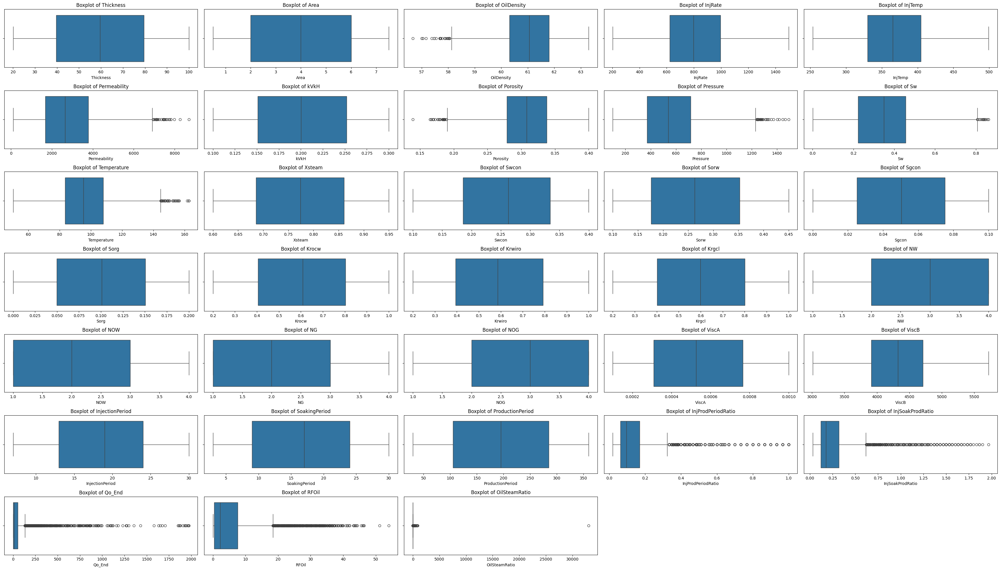

In [61]:
# Boxplot
fig, ax = plt.subplots(nrows=7, ncols=5, figsize=(35, 20))
ax = ax.flatten()

for i, col in enumerate(all_columns) :
    sns.boxplot(data=df, ax=ax[i], x=col)
    ax[i].set_title(f'Boxplot of {col}')

# Hide the 34th and 35th plots (index 33 and 34)
ax[33].axis('off')
ax[34].axis('off')

plt.tight_layout()
plt.show()

Some of the columns have outliers, but not sure yet whether I should filter them or not since I don't really understand the context or domain importance of the columns. So as for now we will keep just keep it that way. If we need to filter them out then we will be using the code of filtering in data processing

In [62]:
# Outlier detection for original data
print(f'Amount of Rows: {len(df)}')

outlier = []
no_outlier = []
is_outlier = []
low_bound = []
high_bound = []

filtered_entries = np.array([True] * len(df))

for col in all_columns:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - (IQR * 1.5)
    upper_bound = Q3 + (IQR * 1.5)

    filter_outlier = ((df[col] >= lower_bound) & (df[col] <= upper_bound))

    outlier.append(len(df[~filter_outlier]))
    no_outlier.append(len(df[filter_outlier]))
    is_outlier.append(df[col][~filter_outlier].any())
    low_bound.append(lower_bound)
    high_bound.append(upper_bound)

    filtered_entries = ((df[col] >= lower_bound) & (df[col] <= upper_bound)) & filtered_entries

print(f'Amount of Outlier Rows : {len(df[~filtered_entries])}')
print(f'Amount of Non-Outlier Rows : {len(df[filtered_entries])}')
print(f'Percentage of Outliers : {round(len(df[~filtered_entries]) / len(df) * 100, 2)}')
print()

percentage_outlier = np.array(outlier) / len(df) * 100
check_outliers = pd.DataFrame({
    'Column Name':all_columns,
    'Outlier Exist': is_outlier,
    'Lower Limit': low_bound,
    'Upper Limit': high_bound,
    'Outlier Data': outlier,
    'Non-Outlier Data': no_outlier,
    'Percentage of Outlier': percentage_outlier
})

check_outliers

Amount of Rows: 5949
Amount of Outlier Rows : 2232
Amount of Non-Outlier Rows : 3717
Percentage of Outliers : 37.52



,Column Name,Outlier Exist,Lower Limit,Upper Limit,Outlier Data,Non-Outlier Data,Percentage of Outlier
0,Thickness,False,-20.270635,139.340949,0,5949,0.000000
1,Area,False,-4.000000,12.000000,0,5949,0.000000
2,OilDensity,True,58.062154,64.052082,25,5924,0.420239
3,InjRate,False,62.839765,1556.765805,0,5949,0.000000
4,InjTemp,False,218.517225,516.062145,0,5949,0.000000
5,Permeability,True,-1473.523850,6938.150950,31,5918,0.521096
6,kVkH,False,-0.000680,0.403655,0,5949,0.000000
7,Porosity,True,0.190202,0.426319,26,5923,0.437048
8,Pressure,True,-144.442710,1232.036170,30,5919,0.504286
9,Sw,True,-0.126812,0.806739,14,5935,0.235334


**The missing values are mostly on the target variables.**

## Multivariate Analysis

In [34]:
# Pairplot of numerical features
sns.pairplot(data=df, diag_kind='kde')
plt.tight_layout()
plt.show()

Mostly the relation are non-linear, so we will be using spearmann method to check the correlation value.

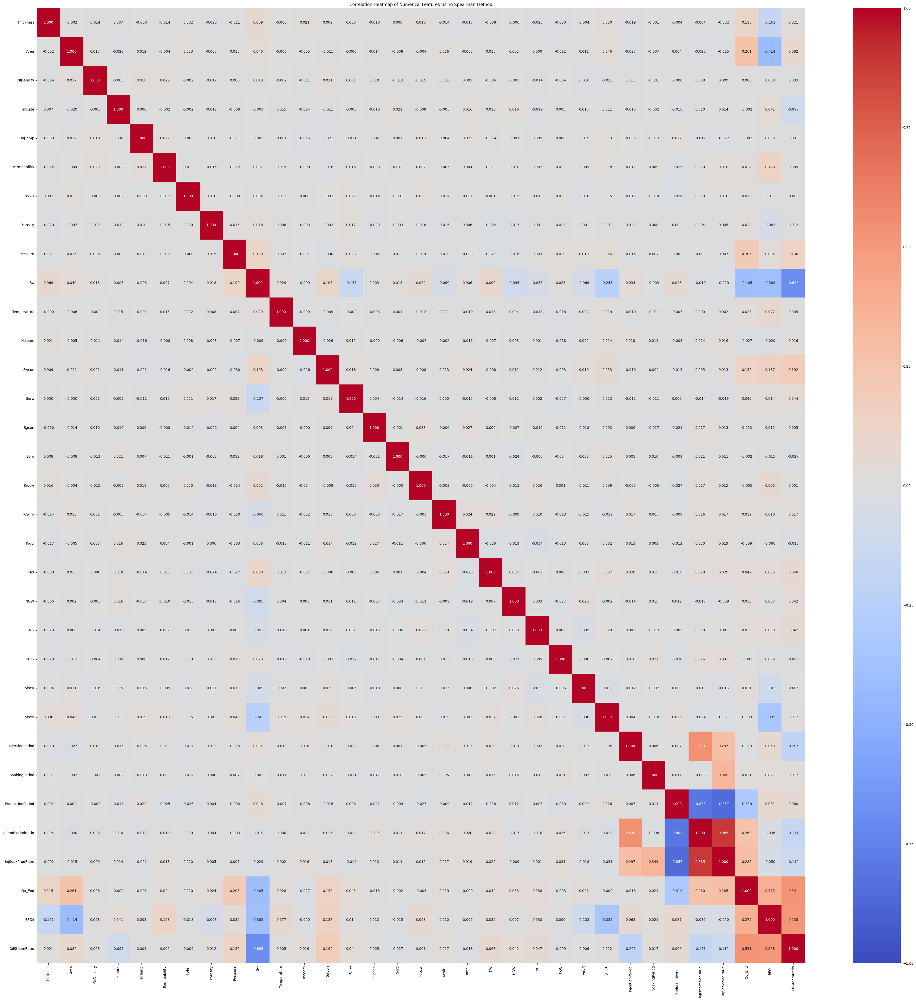

In [63]:
# Heatmap of numerical values (Spearman method)
# fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(12, 20))

plt.figure(figsize=(40, 40))
sns.heatmap(data=df.corr(method='spearman', numeric_only=True),annot=True, cmap='coolwarm', fmt='.3f', vmin=-1, vmax=1)
plt.title('Correlation Heatmap of Numerical Features Using Spearman Method')

# sns.heatmap(data=df.corr(method='kendall', numeric_only=True),annot=True, cmap='coolwarm', fmt='.3f', vmin=-1, vmax=1, ax=ax[1])
# ax[1].set_title('Correlation Heatmap of Numerical Features Using Kendall Method')

plt.tight_layout()
plt.show()

In [64]:
# Feature-Feature correlation representation in tabular form 
corr_feature = df.corr(method='spearman', numeric_only=True)

# Flatten correlation matrix.
flat_cm = corr_feature.stack().reset_index()
flat_cm.columns = ['A', 'B', 'Corr Value']

flat_cm = flat_cm.loc[flat_cm['Corr Value'] < 1, :] # Filter for the feature correlation by itself
flat_cm = flat_cm[~flat_cm['A'].isin(target_columns) & ~flat_cm['B'].isin(target_columns)] # Filter out the target variable(s)

flat_cm['Corr Type'] = flat_cm['Corr Value'].apply(lambda x : 'Positive' if x >= 0 else 'Negative')
flat_cm['Corr Value'] = flat_cm['Corr Value'].apply(lambda x : abs(x))
flat_cm = flat_cm.sort_values(by='Corr Value', ascending=False, ignore_index=True)

redundan_cm = flat_cm.drop_duplicates(subset=['Corr Value', 'Corr Type']).reset_index(drop=True) # Filter for the feature correlation of A-B then B-A
redundan_cm

,A,B,Corr Value,Corr Type
0,Sw,ViscB,0.243194,Negative
1,Sw,Sorw,0.136650,Negative
2,Pressure,Sw,0.108656,Positive
3,Swcon,Sw,0.103377,Positive
4,NOW,Sw,0.094521,Negative
...,...,...,...,...
295,InjTemp,Thickness,0.000213,Negative
296,Krocw,Sorg,0.000172,Negative
297,Sorw,Krwiro,0.000144,Positive
298,Thickness,Sorw,0.000128,Positive


There are no redundancy in feature-feature correlation.

In [65]:
# Feature-Target correlation representation in tabular form 
corr_target = pd.DataFrame()
for target in target_columns:
    corr = df.corrwith(df[target], method='spearman', numeric_only=True)
    corr = corr.to_frame(name=target)
    corr_target = pd.concat([corr_target, corr], axis=1)

# Reset index and melt the dataframe
corr = corr_target.reset_index().melt(id_vars='index', var_name='Target', value_name='Corr Value')
corr = corr[~corr['index'].isin(target_columns)]  # Remove rows where 'index' is in target_columns
corr = corr.rename(columns={'index': 'Feature'})

corr['Corr Type'] = corr['Corr Value'].apply(lambda x : 'Positive' if x >= 0 else 'Negative')
corr['Corr Value'] = corr['Corr Value'].abs()
corr = corr.sort_values('Corr Value', ascending=False, ignore_index=True)
corr

,Feature,Target,Corr Value,Corr Type
0,Sw,OilSteamRatio,0.694692,Negative
1,Area,RFOil,0.414146,Negative
2,Sw,Qo_End,0.404547,Negative
3,Sw,RFOil,0.388760,Negative
4,ViscB,RFOil,0.339094,Negative
...,...,...,...,...
195,Sorg,InjectionPeriod,0.000837,Positive
196,Krgcl,SoakingPeriod,0.000598,Positive
197,OilDensity,SoakingPeriod,0.000580,Negative
198,Temperature,InjProdPeriodRatio,0.000202,Positive


There are no strongly correlated (corr > 0.7) feature to all 8 target variables. But there are so much feature that have very low correlation to targets.

In [66]:
# Checking of specific target variable (Change based on what we want to check)
corr_target_RFOil = corr[corr["Target"] == "RFOil"]
print(len(corr_target_RFOil))
corr_target_RFOil

25


,Feature,Target,Corr Value,Corr Type
1,Area,RFOil,0.414146,Negative
3,Sw,RFOil,0.388760,Negative
4,ViscB,RFOil,0.339094,Negative
8,Thickness,RFOil,0.161393,Negative
9,Swcon,RFOil,0.136605,Positive
12,Permeability,RFOil,0.128408,Positive
14,ViscA,RFOil,0.102957,Negative
17,Temperature,RFOil,0.077027,Positive
19,Krocw,RFOil,0.063360,Positive
20,Porosity,RFOil,0.062611,Negative


# **STAGE 2 : DATA PREPROCESSING**

In [67]:
# Make a copy of original dataframe for preprocessing and encoding process
df_preprocessed = df.copy()
df_preprocessed.sample(5)

,Thickness,Area,OilDensity,InjRate,InjTemp,Permeability,kVkH,Porosity,Pressure,Sw,Temperature,Xsteam,Swcon,Sorw,Sgcon,Sorg,Krocw,Krwiro,Krgcl,NW,NOW,NG,NOG,ViscA,ViscB,InjectionPeriod,SoakingPeriod,ProductionPeriod,InjProdPeriodRatio,InjSoakProdRatio,Qo_End,RFOil,OilSteamRatio
2080,38.627453,7.5,59.909454,474.26414,376.05663,4404.6016,0.207075,0.164769,928.52761,0.342847,75.997243,0.810547,0.101931,0.310336,0.092254,0.195238,0.267936,0.445128,0.961957,4,1,3,4,0.000634,4190.6517,25,6,90,0.277778,0.344444,32.868168,1.540492,0.459864
432,73.513504,4.5,60.281229,834.21509,339.44663,2144.2511,0.138685,0.249887,1158.79060,0.012936,98.337671,0.780672,0.358001,0.349618,0.037384,0.042748,0.799139,0.872435,0.584966,3,4,3,3,0.000370,4674.4555,15,14,120,0.125000,0.241667,128.242190,1.947656,125.782980
3462,72.735063,7.0,61.087785,1019.65830,331.84301,3030.5929,0.297335,0.285944,744.78339,0.553256,107.444650,0.824910,0.323398,0.112227,0.031393,0.145450,0.890845,0.804839,0.331644,4,3,2,2,0.000273,4870.7117,13,18,30,0.433333,1.033333,5.051499,0.039020,0.019707
5919,90.161084,6.5,61.083431,835.45454,369.84203,4793.1568,0.232668,0.266264,714.33510,0.618914,117.534200,0.890408,0.395437,0.383867,0.029087,0.023887,0.999692,0.838638,0.430179,1,1,4,2,0.000114,4215.2545,27,15,285,0.094737,0.147368,0.009277,0.302922,0.080756
679,37.830961,3.5,62.694656,664.80733,367.55733,3099.2520,0.122420,0.268779,962.94728,0.079974,68.974963,0.765837,0.395706,0.162708,0.084861,0.128255,0.767997,0.213567,0.251704,1,3,4,3,0.000365,5043.9091,27,23,255,0.105882,0.196078,10.589356,0.870602,108.811160


## Handling Outliers

Handling outliers is only applied to feature columns

In [68]:
feature_columns

['Thickness',
 'Area',
 'OilDensity',
 'InjRate',
 'InjTemp',
 'Permeability',
 'kVkH',
 'Porosity',
 'Pressure',
 'Sw',
 'Temperature',
 'Xsteam',
 'Swcon',
 'Sorw',
 'Sgcon',
 'Sorg',
 'Krocw',
 'Krwiro',
 'Krgcl',
 'NW',
 'NOW',
 'NG',
 'NOG',
 'ViscA',
 'ViscB']

In [69]:
# Filter the DataFrame to get only rows with outliers
outlier_columns_df = check_outliers[check_outliers["Outlier Data"] > 0]

# Check if the "Column Name" values are in feature_columns
outlier_columns = outlier_columns_df[outlier_columns_df["Column Name"].isin(feature_columns)]

# Extract the unique column names
outlier_column_names = outlier_columns["Column Name"].unique()
outlier_column_names

array(['OilDensity', 'Permeability', 'Porosity', 'Pressure', 'Sw',
       'Temperature'], dtype=object)

In [70]:
# Outlier handling and create outliers-filtered new dataframe

print(f'Rows before removing outliers: {len(df)}')

filtered_entries = np.array([True] * len(df))

for col in outlier_column_names:
    Q1 = df_preprocessed[col].quantile(0.25)
    Q3 = df_preprocessed[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - (IQR * 1.5)
    upper_bound = Q3 + (IQR * 1.5)

    filtered_entries = ((df_preprocessed[col] >= lower_bound) & (df_preprocessed[col] <= upper_bound)) & filtered_entries
    
df_preprocessed = df_preprocessed[filtered_entries]

print(f'Rows after removing outliers: {len(df_preprocessed)}')

df_preprocessed

Rows before removing outliers: 5949
Rows after removing outliers: 5788


,Thickness,Area,OilDensity,InjRate,InjTemp,Permeability,kVkH,Porosity,Pressure,Sw,Temperature,Xsteam,Swcon,Sorw,Sgcon,Sorg,Krocw,Krwiro,Krgcl,NW,NOW,NG,NOG,ViscA,ViscB,InjectionPeriod,SoakingPeriod,ProductionPeriod,InjProdPeriodRatio,InjSoakProdRatio,Qo_End,RFOil,OilSteamRatio
0,39.824628,1.0,62.214501,751.34728,462.20765,832.06533,0.148809,0.301224,581.38029,0.227685,67.889106,0.629472,0.227626,0.295791,0.055293,0.012726,0.863334,0.209767,0.589825,4,4,1,4,0.000811,3506.6960,12,4,105,0.114286,0.152381,64.292969,23.634199,2.528684
1,65.026244,1.0,60.342411,581.50751,305.14547,2598.04390,0.282943,0.217929,523.48885,0.051366,85.752365,0.929950,0.245549,0.133923,0.033127,0.196422,0.285480,0.498191,0.550472,1,2,2,4,0.000845,4349.5874,19,26,330,0.057576,0.136364,21.792969,22.026970,3.169897
2,40.202023,0.5,61.902308,697.68516,356.48412,4391.08380,0.251650,0.308947,286.24688,0.085472,113.455130,0.852801,0.235673,0.366999,0.002201,0.002481,0.602281,0.372117,0.492460,2,1,4,4,0.000785,4597.4855,10,20,75,0.133333,0.400000,21.089846,21.993093,1.566492
3,71.850387,1.0,62.203022,620.03005,449.99169,511.99357,0.290800,0.305564,427.08838,0.226790,87.536629,0.750641,0.374841,0.430492,0.081062,0.196790,0.322498,0.512776,0.621836,3,2,4,4,0.000953,3527.8404,12,29,315,0.038095,0.130159,23.517580,20.947531,4.915453
4,36.984783,1.5,59.734051,907.04751,276.37770,449.83624,0.247424,0.266638,342.83004,0.052586,118.465410,0.765425,0.276477,0.315245,0.073552,0.100621,0.620193,0.663039,0.595623,1,4,1,3,0.000177,3978.8902,9,18,255,0.035294,0.105882,0.740234,20.159119,3.135612
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5943,97.073209,5.5,62.541793,932.05437,319.80661,2725.60710,0.179221,0.270286,1206.23190,0.608577,83.265066,0.804624,0.200351,0.155608,0.031487,0.062027,0.202660,0.898399,0.232364,3,3,4,2,0.000337,4220.7473,10,7,300,0.033333,0.056667,8.484803,0.039914,0.029467
5945,87.024456,7.0,60.337470,619.37454,375.74582,588.58561,0.145092,0.379862,793.86213,0.510405,76.556824,0.677894,0.290219,0.449067,0.010641,0.065236,0.887535,0.234815,0.219329,1,4,1,2,0.000137,4765.4342,15,16,300,0.050000,0.103333,2.471222,0.017784,0.022945
5946,66.577565,5.5,60.372485,687.21770,352.73680,3655.58640,0.232081,0.328860,908.48130,0.546017,81.334023,0.946048,0.396116,0.273756,0.022435,0.137346,0.679492,0.302366,0.920118,1,3,4,3,0.000667,5204.2672,18,7,330,0.054545,0.075758,2.111023,0.064416,0.031316
5947,86.921316,6.0,60.541859,1038.57790,327.78630,1229.85720,0.106178,0.277274,1049.18100,0.519556,84.242217,0.840681,0.362323,0.401904,0.015070,0.077145,0.762990,0.733675,0.567491,4,4,4,4,0.000700,4998.5847,14,13,315,0.044444,0.085714,2.259857,0.041039,0.022655


## Feature Selection

### SelectKBest Feature Importance (Statistical Test)

In [71]:
# Create temporary dataframe for testing SelectKBest
df_feature_target_relation = df_preprocessed.copy()
df_feature_target_relation.head()

,Thickness,Area,OilDensity,InjRate,InjTemp,Permeability,kVkH,Porosity,Pressure,Sw,Temperature,Xsteam,Swcon,Sorw,Sgcon,Sorg,Krocw,Krwiro,Krgcl,NW,NOW,NG,NOG,ViscA,ViscB,InjectionPeriod,SoakingPeriod,ProductionPeriod,InjProdPeriodRatio,InjSoakProdRatio,Qo_End,RFOil,OilSteamRatio
0,39.824628,1.0,62.214501,751.34728,462.20765,832.06533,0.148809,0.301224,581.38029,0.227685,67.889106,0.629472,0.227626,0.295791,0.055293,0.012726,0.863334,0.209767,0.589825,4,4,1,4,0.000811,3506.6960,12,4,105,0.114286,0.152381,64.292969,23.634199,2.528684
1,65.026244,1.0,60.342411,581.50751,305.14547,2598.04390,0.282943,0.217929,523.48885,0.051366,85.752365,0.929950,0.245549,0.133923,0.033127,0.196422,0.285480,0.498191,0.550472,1,2,2,4,0.000845,4349.5874,19,26,330,0.057576,0.136364,21.792969,22.026970,3.169897
2,40.202023,0.5,61.902308,697.68516,356.48412,4391.08380,0.251650,0.308947,286.24688,0.085472,113.455130,0.852801,0.235673,0.366999,0.002201,0.002481,0.602281,0.372117,0.492460,2,1,4,4,0.000785,4597.4855,10,20,75,0.133333,0.400000,21.089846,21.993093,1.566492
3,71.850387,1.0,62.203022,620.03005,449.99169,511.99357,0.290800,0.305564,427.08838,0.226790,87.536629,0.750641,0.374841,0.430492,0.081062,0.196790,0.322498,0.512776,0.621836,3,2,4,4,0.000953,3527.8404,12,29,315,0.038095,0.130159,23.517580,20.947531,4.915453
4,36.984783,1.5,59.734051,907.04751,276.37770,449.83624,0.247424,0.266638,342.83004,0.052586,118.465410,0.765425,0.276477,0.315245,0.073552,0.100621,0.620193,0.663039,0.595623,1,4,1,3,0.000177,3978.8902,9,18,255,0.035294,0.105882,0.740234,20.159119,3.135612


In [72]:
# Calculation of feature importance score to target
from sklearn.feature_selection import SelectKBest, mutual_info_regression

# Separate features and target variable
x_features_test = df_feature_target_relation[feature_columns]  # Features
y_target_test = df_feature_target_relation['RFOil']  # Target variable

# Instantiate SelectKBest
k_best = SelectKBest(score_func=mutual_info_regression, k='all')  # Use 'all' to see scores for all features

# Fit and transform the data
x_selected_features = k_best.fit_transform(x_features_test, y_target_test)

# Get scores, p-values, and feature names
feature_scores = k_best.scores_
feature_pvalues = k_best.pvalues_ # For mutual_info_classif this will display None but not for other method
feature_names = x_features_test.columns

# Create a DataFrame to display feature scores and p-values
feature_scores_df = pd.DataFrame({'Feature': feature_names, 'Score': feature_scores, 'P_Values' : feature_pvalues})
feature_scores_df = feature_scores_df.sort_values(by='Score', ascending=False)

# Display the feature scores and p-values
pd.set_option('display.max_rows', None)  # Set max_rows to None for unlimited rows
display(feature_scores_df)

pd.reset_option('display.max_rows')

,Feature,Score,P_Values
1,Area,0.129314,None
9,Sw,0.110491,None
24,ViscB,0.079860,None
16,Krocw,0.019945,None
12,Swcon,0.016088,None
0,Thickness,0.014492,None
7,Porosity,0.013896,None
11,Xsteam,0.012560,None
14,Sgcon,0.009727,None
17,Krwiro,0.009012,None


This is for checking 1 target variable only, but if we need to check all target altogether :

In [73]:
from sklearn.feature_selection import SelectKBest, mutual_info_regression

# List of target variables
target_variables = target_columns

# Features (excluding all target variables)
x_features_test = df_feature_target_relation.drop(columns=target_variables)

# Dictionary to store results
all_scores = {}

for target in target_variables:
    y_target_test = df_feature_target_relation[target]
    
    k_best = SelectKBest(score_func=mutual_info_regression, k='all')
    k_best.fit(x_features_test, y_target_test)
    
    all_scores[f'{target}_Score'] = k_best.scores_

# Create a DataFrame with all scores
feature_scores_df = pd.DataFrame(all_scores)
feature_scores_df['Feature'] = x_features_test.columns

# Calculate average score across all targets
score_columns = [col for col in feature_scores_df.columns if col.endswith('_Score')]
feature_scores_df['Average_Score'] = feature_scores_df[score_columns].mean(axis=1)

# Reorder columns to put 'Feature' first
columns_order = ['Feature'] + score_columns + ['Average_Score']
feature_scores_df = feature_scores_df[columns_order]

# Sort the DataFrame by the average score
feature_scores_df = feature_scores_df.sort_values('Average_Score', ascending=False)

# Reset index for clean display
feature_scores_df = feature_scores_df.reset_index(drop=True)

# Display the results
display(feature_scores_df)

,Feature,InjectionPeriod_Score,SoakingPeriod_Score,ProductionPeriod_Score,InjProdPeriodRatio_Score,InjSoakProdRatio_Score,Qo_End_Score,RFOil_Score,OilSteamRatio_Score,Average_Score
0,Sw,0.019158,0.000000,0.000000,0.000000,0.013237,0.119359,0.110493,0.321471,0.072965
1,Area,0.007018,0.013747,0.000000,0.019997,0.015056,0.065917,0.129687,0.033166,0.035574
2,ViscB,0.000000,0.011182,0.000000,0.000000,0.009872,0.123634,0.079861,0.049560,0.034264
3,Pressure,0.000000,0.000000,0.024016,0.004477,0.001953,0.029140,0.005073,0.028954,0.011702
4,InjTemp,0.000000,0.001897,0.016327,0.000000,0.022894,0.021537,0.000000,0.013348,0.009501
5,Krgcl,0.006945,0.007216,0.005689,0.025417,0.024761,0.000000,0.000000,0.004844,0.009359
6,Swcon,0.015358,0.000000,0.007771,0.000000,0.000000,0.010734,0.016088,0.023015,0.009121
7,Krocw,0.000000,0.000000,0.000481,0.022307,0.002630,0.017228,0.019945,0.006044,0.008579
8,Porosity,0.000000,0.000000,0.006985,0.017487,0.019433,0.004371,0.013887,0.000301,0.007808
9,Krwiro,0.007753,0.003696,0.000000,0.012777,0.000000,0.011830,0.009009,0.003931,0.006124


In [74]:
# Select only relevant features for each cases before moving to modelling process
df_model = df_preprocessed.copy()

# Important features only based on correlation and K-best parameter
selected_features = df_preprocessed.columns

df_model = df_model[selected_features]

## Split Train and Test Data

In [75]:
selected_features

Index(['Thickness', 'Area', 'OilDensity', 'InjRate', 'InjTemp', 'Permeability',
       'kVkH', 'Porosity', 'Pressure', 'Sw', 'Temperature', 'Xsteam', 'Swcon',
       'Sorw', 'Sgcon', 'Sorg', 'Krocw', 'Krwiro', 'Krgcl', 'NW', 'NOW', 'NG',
       'NOG', 'ViscA', 'ViscB', 'InjectionPeriod', 'SoakingPeriod',
       'ProductionPeriod', 'InjProdPeriodRatio', 'InjSoakProdRatio', 'Qo_End',
       'RFOil', 'OilSteamRatio'],
      dtype='object')

In [76]:
# Split Train and Test Data
X = df_model.drop(columns=target_columns)
y = df_model[target_columns]

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Check dimension of train and test data
print(f'Dimension of x_train data : {X_train.shape}')
print(f'Dimension of y_train data : {y_train.shape}')
print(f'Dimension of x_test data : {X_test.shape}')
print(f'Dimension of y_test data : {y_test.shape}')

Dimension of x_train data : (4630, 25)
Dimension of y_train data : (4630, 8)
Dimension of x_test data : (1158, 25)
Dimension of y_test data : (1158, 8)


## Feature Scalling

In [77]:
len(X_train.columns)

25

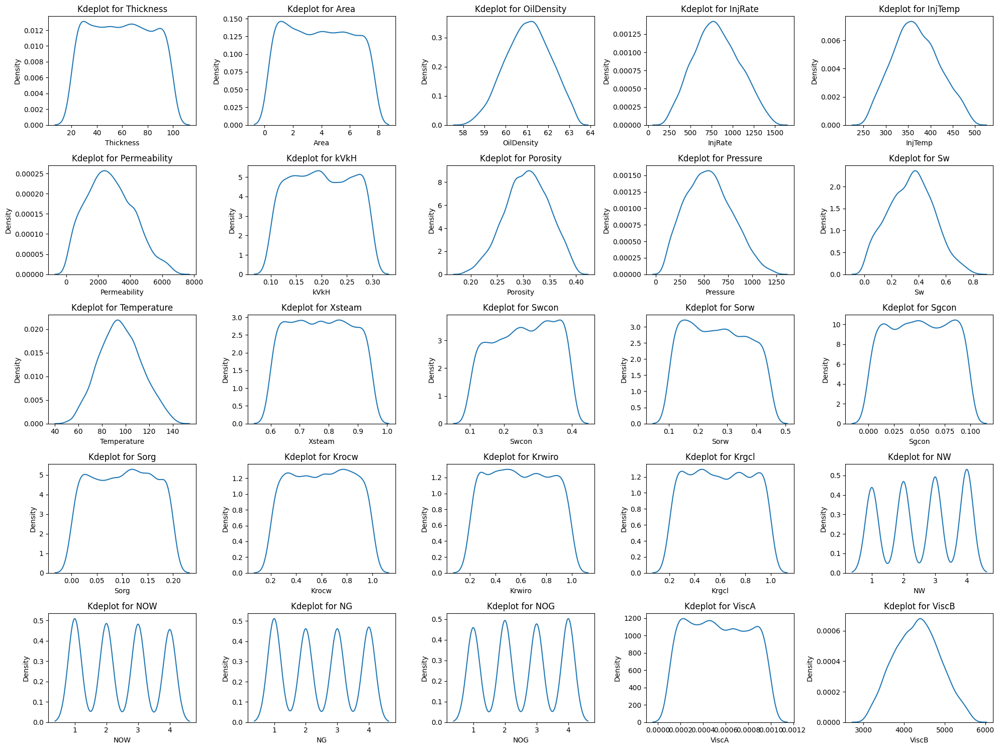

In [78]:
# Re-check distribution before scaling
fig, ax = plt.subplots(nrows=5, ncols=5, figsize=(20, 15))
ax = ax.flatten()

for i, col in enumerate(X_train.columns) :
    sns.kdeplot(data=X_train, x=col, ax=ax[i])
    ax[i].set_title(f'Kdeplot for {col}')

plt.tight_layout()
plt.show()

Based on the distribution above :

- **For uniform distributions:**

    - Normalization is generally a good choice as it preserves the uniform nature of the distribution while scaling it to a fixed range.


- **For multi-modal distributions:**

    Using standardization for feature scaling when the distribution is multi-modal may not be ideal. Here's a brief explanation why:

    1. Standardization assumes a normal distribution: It transforms features to have a mean of 0 and a standard deviation of 1, which works well for normally distributed data.

    2. Multi-modal distributions: These have multiple peaks, indicating distinct subgroups within the data. Standardization can obscure these important characteristics.

    3. Potential issues:
    - Loss of information about subgroups
    - Misrepresentation of the data's structure
    - Reduced effectiveness of algorithms that rely on distance measures

    Alternative approaches:

    1. Robust scaling: Using median and interquartile range instead of mean and standard deviation.
    2. Normalization: Scaling features to a fixed range (e.g., 0 to 1).
    3. Separate scaling: Treating each mode as a separate group and scaling them individually.
    4. Non-linear transformations: Applying methods like log transformation or Box-Cox to address non-normality.

- **For right-skewed distributions :**

    The goal is to make the distribution more symmetric and closer to normal. Here are some common transformations for right-skewed data:

    - Logarithmic transformation:

        - Most common for right-skewed data
        - log(x) or log(x + 1) if there are zeros in the data
        - Effective for data with a wide range of values


    - Square root transformation:

        - sqrt(x)
        - Less drastic than log transformation
        - Useful for count data or when log is too extreme

- **Exploring advanced techniques like:**

    - Quantile transformation: This can help in spreading out the most frequent values.

    - Power transforms (e.g., Box-Cox or Yeo-Johnson): These can help in making the distribution more Gaussian-like.

--------------------------------------------------------------------------------------

**Reminder About Choosing Scaling Methods**

If the issue is primarily with the range of values rather than the shape of the distributions, you can use scaling methods to bring all features to a similar scale without altering their distributions. Here are some common scaling methods you can consider:

1. **Min-Max Scaling (Normalization)**:
   - Scales the data to a fixed range, usually between 0 and 1.
   - Formula: \( X_{\text{scaled}} = \frac{X - X_{\text{min}}}{X_{\text{max}} - X_{\text{min}}} \)
   - Use when you know the minimum and maximum values for your features or when you want to bound the data within a specific range.

2. **Standard Scaling (Standardization)**:
   - Scales the data so that it has a mean of 0 and a standard deviation of 1.
   - Formula: \( X_{\text{scaled}} = \frac{X - \mu}{\sigma} \)
   - Use when the features are normally distributed or when you're using models that assume zero-centered data.

3. **Robust Scaling**:
   - Scales the data similarly to standard scaling but uses the median and the interquartile range (IQR) instead of the mean and standard deviation.
   - Formula: \( X_{\text{scaled}} = \frac{X - \text{median}(X)}{\text{IQR}(X)} \)
   - Use when the data contains outliers or when the distribution is not normal.

4. **Max Abs Scaler**:
   - Scales each feature to its maximum absolute value.
   - Formula: \( X_{\text{scaled}} = \frac{X}{\max(|X|)} \)
   - Use when the features are sparse or when you want to preserve sparsity.

5. **Power Transformer (Yeo-Johnson or Box-Cox)**:
   - Applies a power transformation to make the data more Gaussian-like.
   - Use when the data is skewed or when you need to stabilize variance.

For your case where the overall feature distributions are near normal but the ranges vary significantly, Min-Max Scaling or Standard Scaling might be appropriate. If you're concerned about outliers, Robust Scaling could be a better choice. It's often a good idea to try different scaling methods and see which one works best for your specific dataset and model.

In [79]:
# Apply feature scalling
from sklearn.preprocessing import MinMaxScaler, StandardScaler

ms = MinMaxScaler()
ss = StandardScaler()

apply_normalization_columns = ['Thickness', 'Area', 'kVkH', 'Xsteam', 'Swcon', 'Sorw', 'Sgcon', 'Sorg',
                               'Krocw', 'Krwiro', 'Krgcl', 'NW', 'NOW', 'NG', 'NOG', 'ViscA']

apply_standardization_columns = ['OilDensity', 'InjRate', 'InjTemp', 'Permeability',
                                 'Porosity', 'Pressure', 'Sw', 'Temperature', 'ViscB']

# Apply min-max scaling
X_train[apply_normalization_columns] = ms.fit_transform(X_train[apply_normalization_columns])
X_test[apply_normalization_columns] = ms.transform(X_test[apply_normalization_columns])

# Apply standardization
X_train[apply_standardization_columns] = ss.fit_transform(X_train[apply_standardization_columns])
X_test[apply_standardization_columns] = ss.transform(X_test[apply_standardization_columns])

In [80]:
# Statistical summary of mean and standard deviation after scale with standardization
X_train[apply_standardization_columns].describe().transpose()[['mean', 'std']]

,mean,std
OilDensity,3.403853e-15,1.000108
InjRate,7.443050e-17,1.000108
InjTemp,-7.335625e-16,1.000108
Permeability,-1.450244e-16,1.000108
Porosity,-9.591560e-17,1.000108
Pressure,-2.593558e-16,1.000108
Sw,-4.603949e-17,1.000108
Temperature,6.445528e-17,1.000108
ViscB,1.015938e-15,1.000108


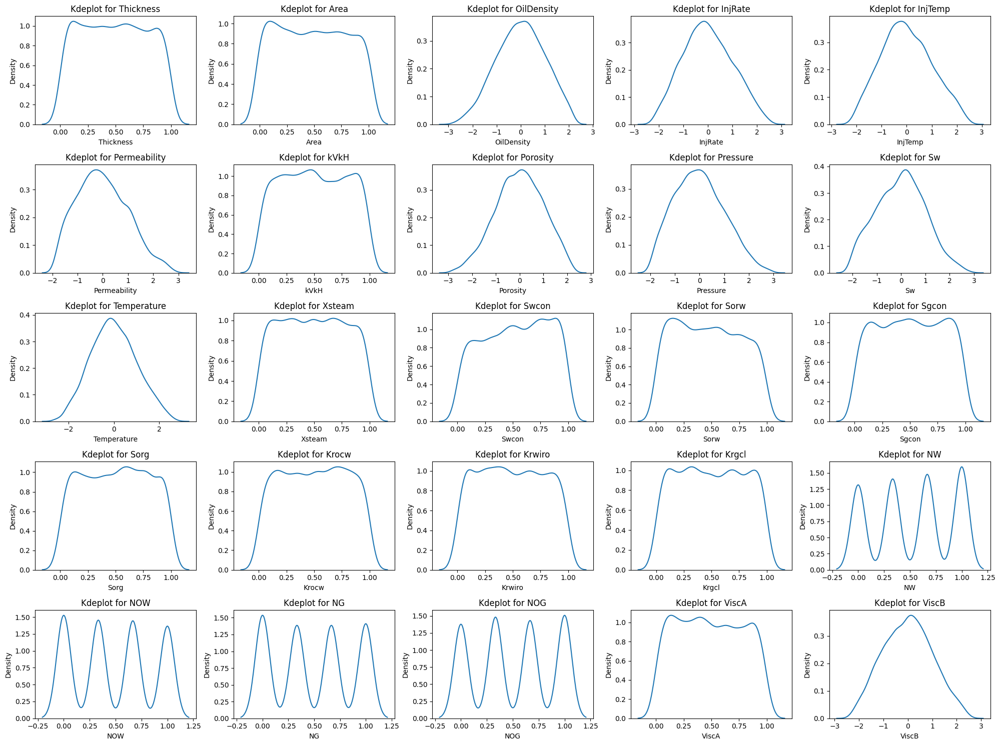

In [81]:
# Checking distribution after scaling
fig, ax = plt.subplots(nrows=5, ncols=5, figsize=(20, 15))
ax = ax.flatten()

for i, col in enumerate(X_train.columns) :
    sns.kdeplot(data=X_train, x=col, ax=ax[i])
    ax[i].set_title(f'Kdeplot for {col}')

plt.tight_layout()
plt.show()

In [82]:
X_train

,Thickness,Area,OilDensity,InjRate,InjTemp,Permeability,kVkH,Porosity,Pressure,Sw,Temperature,Xsteam,Swcon,Sorw,Sgcon,Sorg,Krocw,Krwiro,Krgcl,NW,NOW,NG,NOG,ViscA,ViscB
869,0.982062,0.285714,-0.487328,-0.406640,0.434826,-1.394240,0.942803,0.649237,0.151754,-0.636153,-0.313673,0.902730,0.765028,0.209731,0.515333,0.683893,0.858652,0.259475,0.860773,0.666667,1.000000,0.666667,0.000000,0.508924,0.880632
5663,0.995347,0.857143,-0.302310,-0.884376,-0.294729,-1.043761,0.514627,-0.844209,-0.634520,-0.184048,0.223502,0.658064,0.314018,0.545259,0.887683,0.660698,0.652801,0.150038,0.337495,0.000000,0.000000,0.666667,0.666667,0.096724,-1.534614
400,0.577340,0.428571,-1.639892,1.404064,-1.270709,-0.577417,0.439062,0.412623,2.711900,1.114374,-0.230910,0.831887,0.464073,0.099505,0.056140,0.941432,0.585696,0.033975,0.529477,0.333333,0.666667,0.000000,0.333333,0.139441,0.257045
4489,0.008142,0.928571,-1.689310,0.398265,-0.629400,-0.638629,0.765516,-2.307600,-0.113852,0.207784,0.760036,0.250333,0.139900,0.616293,0.099362,0.316556,0.596596,0.806639,0.995481,0.666667,0.333333,1.000000,0.000000,0.058958,-0.569097
2448,0.716625,0.214286,0.460926,1.530753,-0.286633,1.363435,0.787930,-0.000356,-0.808064,-0.532300,-1.798722,0.366761,0.546812,0.703290,0.512760,0.989436,0.274857,0.369610,0.727842,0.000000,0.000000,1.000000,0.333333,0.962911,-0.103647
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3865,0.994122,0.000000,-0.494327,-0.987371,2.076439,0.856896,0.582641,-0.564975,-0.603676,0.255385,-1.385461,0.521760,0.482973,0.339004,0.867652,0.207218,0.464027,0.212225,0.085055,1.000000,0.333333,0.666667,0.666667,0.542723,-0.285671
5326,0.323352,0.571429,-1.424135,-0.176506,-0.413984,1.293359,0.184823,0.521501,0.425630,1.550221,1.430202,0.655075,0.883032,0.153978,0.988519,0.581928,0.468378,0.480726,0.461429,1.000000,1.000000,1.000000,0.000000,0.382102,-1.002994
5365,0.740743,0.142857,1.300787,0.594478,-0.086572,0.114100,0.153626,-1.481832,1.950006,1.275264,-1.750642,0.869829,0.170100,0.756546,0.101621,0.872271,0.151119,0.465553,0.286475,0.666667,0.333333,1.000000,1.000000,0.533441,-0.926216
5537,0.865904,0.928571,0.301193,0.329301,-0.529860,0.052715,0.146376,-2.286440,1.553367,0.594455,1.030555,0.526080,0.751159,0.834379,0.105807,0.472589,0.615996,0.117278,0.521177,0.000000,0.333333,1.000000,1.000000,0.841421,-0.907031


In [83]:
X_test

,Thickness,Area,OilDensity,InjRate,InjTemp,Permeability,kVkH,Porosity,Pressure,Sw,Temperature,Xsteam,Swcon,Sorw,Sgcon,Sorg,Krocw,Krwiro,Krgcl,NW,NOW,NG,NOG,ViscA,ViscB
5085,0.404490,0.642857,-1.478221,1.102475,-0.412818,-1.521097,0.871487,0.995279,-1.450480,0.137053,0.093354,0.257078,0.611555,0.364780,0.537582,0.749501,0.443114,0.444023,0.242337,0.333333,0.666667,0.000000,0.333333,0.878923,0.569302
4856,0.436037,0.071429,0.172983,1.442723,0.649295,-0.768468,0.297807,1.717752,-0.612729,1.074247,-0.264760,0.505913,0.995486,0.078730,0.286762,0.444131,0.065315,0.900404,0.683307,0.000000,0.333333,0.666667,0.000000,0.608328,-0.021686
1084,0.045373,1.000000,0.830824,-0.362116,-0.058808,-0.017254,0.062622,-0.774012,-0.827864,0.660095,-0.310807,0.407854,0.707121,0.223254,0.358293,0.006436,0.317121,0.191305,0.217919,0.333333,1.000000,0.666667,0.333333,0.579934,0.345642
1744,0.924626,0.000000,-0.858014,-0.247170,-0.280094,0.371536,0.584557,1.602463,-0.505937,1.038403,-0.372054,0.596084,0.318176,0.294347,0.845761,0.433015,0.448962,0.228817,0.016916,0.000000,0.000000,1.000000,1.000000,0.232312,-2.170444
162,0.800596,0.714286,-0.244180,0.465878,-0.465670,-1.613478,0.601682,0.275382,-0.947242,-1.274824,-0.701054,0.078182,0.766090,0.552288,0.412857,0.049106,0.627238,0.780952,0.692467,0.666667,0.333333,1.000000,0.666667,0.212203,-0.817120
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4796,0.749974,0.071429,-2.120686,0.533781,-0.725361,0.831095,0.349808,-0.744188,1.831324,1.236086,0.158564,0.462494,0.983833,0.885085,0.609032,0.121342,0.986893,0.927487,0.209718,1.000000,0.333333,1.000000,0.666667,0.414047,0.540658
5837,0.949618,0.714286,1.138067,-0.839627,-0.628174,-0.184801,0.773902,1.587353,0.262699,0.306578,0.199029,0.039142,0.150706,0.402997,0.458151,0.004050,0.641903,0.151159,0.818152,0.333333,0.333333,1.000000,0.666667,0.265539,0.634481
5455,0.469622,0.571429,-0.857384,0.658583,-0.376322,1.252136,0.595689,-0.406454,-0.123233,-0.286866,-0.898005,0.156004,0.387249,0.890420,0.051598,0.725774,0.743788,0.635384,0.582655,0.666667,0.000000,0.333333,0.000000,0.692790,-1.781472
209,0.032146,0.857143,0.772698,-1.330308,-1.917391,2.417013,0.753143,-1.177016,-0.021826,-0.783010,1.120111,0.632351,0.644924,0.332952,0.942866,0.515409,0.919032,0.304985,0.094533,0.666667,1.000000,0.333333,0.000000,0.303231,1.977210


In [84]:
y_train

,InjectionPeriod,SoakingPeriod,ProductionPeriod,InjProdPeriodRatio,InjSoakProdRatio,Qo_End,RFOil,OilSteamRatio
869,19,6,150,0.126667,0.166667,14.107911,0.433549,45.643467
5663,15,18,225,0.066667,0.146667,48.125004,8.700425,10.897714
400,11,9,300,0.036667,0.066667,25.220705,2.170598,0.739214
4489,18,18,60,0.300000,0.600000,60.935062,3.787662,0.409240
2448,20,15,255,0.078431,0.137255,52.966801,10.392565,1.394049
...,...,...,...,...,...,...,...,...
3865,26,19,270,0.096296,0.166667,0.000000,12.271493,0.678737
5326,26,24,270,0.096296,0.185185,12.791016,6.023952,0.811700
5365,11,19,285,0.038596,0.105263,0.001434,0.091657,0.012872
5537,27,19,75,0.360000,0.613333,71.999390,0.198428,0.066004


In [85]:
y_test

,InjectionPeriod,SoakingPeriod,ProductionPeriod,InjProdPeriodRatio,InjSoakProdRatio,Qo_End,RFOil,OilSteamRatio
5085,25,22,225,0.111111,0.208889,1.207886,0.324036,0.059426
4856,24,8,270,0.088889,0.118519,0.000000,0.292816,0.009167
1084,7,10,195,0.035897,0.087179,1.138275,0.202505,0.096016
1744,10,15,90,0.111111,0.277778,0.000000,7.468742,0.779446
162,15,18,285,0.052632,0.115789,116.468760,5.302317,5.336510
...,...,...,...,...,...,...,...,...
4796,11,9,60,0.183333,0.333333,76.569832,2.907296,0.311652
5837,28,24,300,0.093333,0.173333,12.728027,0.348581,0.246593
5455,30,24,90,0.333333,0.600000,468.796910,16.972330,2.875935
209,23,28,360,0.063889,0.141667,17.696291,4.317562,3.472871


# **STAGE 3 : MODELLING AND EVALUATION**

#### Trial training using the multi output regression concept

In [ ]:
# Create and train the Multi-Output Regressor
from sklearn.multioutput import MultiOutputRegressor
from sklearn.ensemble import RandomForestRegressor  # or any other base regressor
from sklearn.metrics import mean_squared_error, r2_score

multi_output_regressor = MultiOutputRegressor(RandomForestRegressor(n_estimators=100, random_state=42))
multi_output_regressor.fit(X_train, y_train)

# Make predictions
y_pred = multi_output_regressor.predict(X_test)

# Evaluate the model
for i, target in enumerate(target_variables):
    mse = mean_squared_error(y_test.iloc[:, i], y_pred[:, i])
    r2 = r2_score(y_test.iloc[:, i], y_pred[:, i])
    print(f"\nMetrics for {target}:")
    print(f"Mean Squared Error: {mse}")
    print(f"R2 Score: {r2}")

# If you want to see some predictions
print("\nSample predictions:")
display(pd.DataFrame(y_pred[:5], columns=target_variables))


Metrics for InjectionPeriod:
Mean Squared Error: 50.193713613445375
R2 Score: -0.03311939380367468

Metrics for SoakingPeriod:
Mean Squared Error: 65.81312924369747
R2 Score: -0.027867827107634913

Metrics for ProductionPeriod:
Mean Squared Error: 10146.612478991596
R2 Score: -0.004558388368083088

Metrics for InjProdPeriodRatio:
Mean Squared Error: 0.025802579823636373
R2 Score: -0.08983463152874616

Metrics for InjSoakProdRatio:
Mean Squared Error: 0.08500192447290876
R2 Score: -0.08548414022199236

Metrics for Qo_End:
Mean Squared Error: 17814.21180173819
R2 Score: 0.2025218192593583

Metrics for RFOil:
Mean Squared Error: 18.980017416029725
R2 Score: 0.743224320760586

Metrics for OilSteamRatio:
Mean Squared Error: 1716.7883177627912
R2 Score: 0.33775938478573597

Sample predictions:


,InjectionPeriod,SoakingPeriod,ProductionPeriod,InjProdPeriodRatio,InjSoakProdRatio,Qo_End,RFOil,OilSteamRatio
0,20.67,17.18,163.20,0.320259,0.529294,79.381753,23.226794,76.896222
1,16.74,16.77,216.30,0.137561,0.312474,133.709047,12.123545,2.332145
2,19.54,17.17,196.20,0.115465,0.206069,108.149696,3.509080,3.851126
3,18.80,17.47,203.85,0.121184,0.251650,38.322151,6.591093,0.212715
4,19.44,15.80,197.55,0.146653,0.232893,20.420430,0.878580,10.203168


### Helper Function

First we will define some functions that will help us in the process of training and evaluation.

In [ ]:
# Make predictions
y_pred = multi_output_regressor.predict(X_test)

# Evaluate the model
for i, target in enumerate(target_variables):
    mse = mean_squared_error(y_test.iloc[:, i], y_pred[:, i])
    r2 = r2_score(y_test.iloc[:, i], y_pred[:, i])
    print(f"\nMetrics for {target}:")
    print(f"Mean Squared Error: {mse}")
    print(f"R2 Score: {r2}")

# If you want to see some predictions
print("\nSample predictions:")
display(pd.DataFrame(y_pred[:5], columns=target_variables))

In [42]:
# Import metrics score that will be evalueated
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error, r2_score
from sklearn.model_selection import cross_validate
from sklearn.model_selection import RepeatedKFold
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
import time

# Evaluation score calculation
def eval_regression(model):
    y_pred = model.predict(X_test)
    y_pred_train = model.predict(X_train)

    # Evaluate the model
    for i, target in enumerate(target_variables):
        mae_test = mean_absolute_error(y_test.iloc[:, i], y_pred[:, i])
        mae_train = mean_absolute_error(y_train.iloc[:, i], y_pred_train[:, i])

        rmse_test = mean_squared_error(y_test.iloc[:, i], y_pred[:, i], squared=False)
        rmse_train = mean_squared_error(y_train.iloc[:, i], y_pred_train[:, i], squared=False)

        mape_test = mean_absolute_percentage_error(y_test.iloc[:, i], y_pred[:, i])
        mape_train = mean_absolute_percentage_error(y_train.iloc[:, i], y_pred_train[:, i])

        r2_test = r2_score(y_test.iloc[:, i], y_pred[:, i])
        r2_train = r2_score(y_train.iloc[:, i], y_pred_train[:, i])

        # Print evaluation scores
        print(f"\nMetrics for {target}:")
        print(f"MAE Score (Test Set): {mae_test:.2f}")
        print(f"MAE Score (Train Set): {mae_train:.2f}")

        print(f"RMSE Score (Test Set): {rmse_test:.2f}")
        print(f"RMSE Score (Train Set): {rmse_train:.2f}")

        print(f"MAPE Score (Test Set): {mape_test:.2f}")
        print(f"MAPE Score (Train Set): {mape_train:.2f}")

        print(f"R2 Score (Test Set): {r2_test:.2f}")
        print(f"R2 Score (Train Set): {r2_train:.2f}")

        # Cross Validation
        cv = RepeatedKFold(n_splits=7, n_repeats=7, random_state=42)
        score = cross_validate(model, X_train, y_train.iloc[:, i], cv=cv, scoring='r2', return_train_score=True)
        print(f"R2 Score (Crossval Test): {score['test_score'].mean():.2f}") 
        print(f"R2 Score (Crossval Train): {score['train_score'].mean():.2f}")

def grid_pipe(pipedict, hyperdict, scoring='r2', display=True):
    fitted_models = {}
    fit_time = []
    for name, pipeline in pipedict.items():

    # Construct grid search
        cv = RepeatedKFold(n_splits=7, n_repeats=7, random_state=42)
        model = GridSearchCV(estimator=pipeline,
                             param_grid=hyperdict[name],
                             scoring=scoring,
                             cv=cv, verbose=2, n_jobs=-1, return_train_score = True, error_score='raise')

        # Fit using grid search
        start = time.time()
        model.fit(X_train, y_train)
        end = time.time()
        fit_time.append(round(end-start, 2))

        # Append model
        fitted_models[name]=model
        if display:
            #Print when the model has been fitted
            print(f'The {name} model has been fitted.')
            # print fit time
            print('Total Fit Time: %.3fs' % (end-start))
            # Best accuracy
            print('Best R2 Score: %.3f' % model.best_score_)
            # Best params
            print('Best params:\n', model.best_params_,'\n')

    return fitted_models, fit_time

In [88]:
from sklearn.multioutput import MultiOutputRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error, r2_score
from sklearn.model_selection import RepeatedKFold, cross_validate

# Initialize and train the model
dt = MultiOutputRegressor(DecisionTreeRegressor(random_state=42))
dt.fit(X_train, y_train)

def eval_regression(model):
    y_pred = model.predict(X_test)
    y_pred_train = model.predict(X_train)

    # Evaluate the model
    for i, target in enumerate(target_variables):
        mae_test = mean_absolute_error(y_test.iloc[:, i], y_pred[:, i])
        mae_train = mean_absolute_error(y_train.iloc[:, i], y_pred_train[:, i])

        rmse_test = mean_squared_error(y_test.iloc[:, i], y_pred[:, i], squared=False)
        rmse_train = mean_squared_error(y_train.iloc[:, i], y_pred_train[:, i], squared=False)

        mape_test = mean_absolute_percentage_error(y_test.iloc[:, i], y_pred[:, i])
        mape_train = mean_absolute_percentage_error(y_train.iloc[:, i], y_pred_train[:, i])

        r2_test = r2_score(y_test.iloc[:, i], y_pred[:, i])
        r2_train = r2_score(y_train.iloc[:, i], y_pred_train[:, i])

        # Print evaluation scores
        print(f"\nMetrics for {target}:")
        print(f"MAE Score (Test Set): {mae_test:.2f}")
        print(f"MAE Score (Train Set): {mae_train:.2f}")
        print(f"RMSE Score (Test Set): {rmse_test:.2f}")
        print(f"RMSE Score (Train Set): {rmse_train:.2f}")
        print(f"MAPE Score (Test Set): {mape_test:.2f}")
        print(f"MAPE Score (Train Set): {mape_train:.2f}")
        print(f"R2 Score (Test Set): {r2_test:.2f}")
        print(f"R2 Score (Train Set): {r2_train:.2f}")

        # Cross Validation
        cv = RepeatedKFold(n_splits=7, n_repeats=7, random_state=42)
        score = cross_validate(model, X_train, y_train.iloc[:, i], cv=cv, scoring='r2', return_train_score=True)
        print(f"R2 Score (Crossval Test): {score['test_score'].mean():.2f}") 
        print(f"R2 Score (Crossval Train): {score['train_score'].mean():.2f}")

# Evaluate the model
eval_regression(dt)


Metrics for InjectionPeriod:
MAE Score (Test Set): 7.79
MAE Score (Train Set): 0.00
RMSE Score (Test Set): 9.49
RMSE Score (Train Set): 0.00
MAPE Score (Test Set): 0.53
MAPE Score (Train Set): 0.00
R2 Score (Test Set): -0.92
R2 Score (Train Set): 1.00


ValueError: 
All the 49 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
49 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Cikal Merdeka\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py", line 890, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Cikal Merdeka\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py", line 1351, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\Cikal Merdeka\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\multioutput.py", line 245, in fit
    raise ValueError(
ValueError: y must have at least two dimensions for multi-output regression but has only one.


### Train Vanilla Models

In [43]:
# Import models
from sklearn.multioutput import MultiOutputRegressor
from sklearn.svm import SVR
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor
from sklearn.neural_network import MLPRegressor

# Initialize object for each model
svr = MultiOutputRegressor(SVR())
gpr = MultiOutputRegressor(GaussianProcessRegressor(random_state=42))
knn = MultiOutputRegressor(KNeighborsRegressor())
dt = MultiOutputRegressor(DecisionTreeRegressor(random_state=42))
rf = MultiOutputRegressor(RandomForestRegressor(random_state=42))
gb = MultiOutputRegressor(GradientBoostingRegressor(random_state=42))
xgb = MultiOutputRegressor(XGBRegressor(random_state=42))
mlp = MultiOutputRegressor(MLPRegressor(random_state=42))

models = [svr, gpr, knn, dt, rf, gb, xgb, mlp]

# Train models
for model in models :
    model.fit(X_train, y_train)

### Evaluate Vanilla Models

#### SVM

In [42]:
eval_regression(svr)

MAE Score (Test Set): 21.52
MAE Score (Train Set): 19.88
RMSE Score (Test Set): 40.36
RMSE Score (Train Set): 39.70
MAPE Score (Test Set): 597204332137530.75
MAPE Score (Train Set): 789296331427461.12
R2 Score (Test Set): 0.03
R2 Score (Train Set): 0.17


#### GPR

In [216]:
eval_regression(gpr)

MAE Score (Test Set): 0.47
MAE Score (Train Set): 0.00
RMSE Score (Test Set): 1.05
RMSE Score (Train Set): 0.00
MAPE Score (Test Set): 1.00
MAPE Score (Train Set): 0.00
R2 Score (Test Set): -0.24
R2 Score (Train Set): 1.00
R2 Score (Crossval Test): 0.07
R2 Score (Crossval Train): 1.00


#### K-Nearest Neighbours

In [217]:
eval_regression(knn)

MAE Score (Test Set): 0.46
MAE Score (Train Set): 0.26
RMSE Score (Test Set): 0.78
RMSE Score (Train Set): 0.50
MAPE Score (Test Set): 15.94
MAPE Score (Train Set): 18.58
R2 Score (Test Set): 0.32
R2 Score (Train Set): 0.53
R2 Score (Crossval Test): -0.17
R2 Score (Crossval Train): 0.50


#### Decision Tree

In [44]:
eval_regression(dt)


Metrics for InjectionPeriod:
MAE Score (Test Set): 7.79
MAE Score (Train Set): 0.00
RMSE Score (Test Set): 9.49
RMSE Score (Train Set): 0.00
MAPE Score (Test Set): 0.53
MAPE Score (Train Set): 0.00
R2 Score (Test Set): -0.92
R2 Score (Train Set): 1.00


ValueError: 
All the 49 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
49 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Cikal Merdeka\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py", line 890, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Cikal Merdeka\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py", line 1351, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\Cikal Merdeka\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\multioutput.py", line 245, in fit
    raise ValueError(
ValueError: y must have at least two dimensions for multi-output regression but has only one.


#### Random Forest

In [219]:
eval_regression(rf)

MAE Score (Test Set): 1.06
MAE Score (Train Set): 0.11
RMSE Score (Test Set): 1.23
RMSE Score (Train Set): 0.23
MAPE Score (Test Set): 64.59
MAPE Score (Train Set): 3.99
R2 Score (Test Set): -0.69
R2 Score (Train Set): 0.90
R2 Score (Crossval Test): 0.01
R2 Score (Crossval Train): 0.90


#### GradientBoost

In [220]:
eval_regression(gb)

MAE Score (Test Set): 0.73
MAE Score (Train Set): 0.08
RMSE Score (Test Set): 0.99
RMSE Score (Train Set): 0.11
MAPE Score (Test Set): 56.88
MAPE Score (Train Set): 5.11
R2 Score (Test Set): -0.09
R2 Score (Train Set): 0.98
R2 Score (Crossval Test): -0.40
R2 Score (Crossval Train): 0.98


#### XGBoost

In [221]:
eval_regression(xgb)

MAE Score (Test Set): 0.99
MAE Score (Train Set): 0.00
RMSE Score (Test Set): 1.25
RMSE Score (Train Set): 0.00
MAPE Score (Test Set): 54.53
MAPE Score (Train Set): 0.17
R2 Score (Test Set): -0.75
R2 Score (Train Set): 1.00
R2 Score (Crossval Test): -0.79
R2 Score (Crossval Train): 1.00


#### Multi Layer Perceptron (MLP)

In [222]:
eval_regression(mlp)

MAE Score (Test Set): 10.37
MAE Score (Train Set): 0.10
RMSE Score (Test Set): 13.93
RMSE Score (Train Set): 0.23
MAPE Score (Test Set): 422.39
MAPE Score (Train Set): 13.92
R2 Score (Test Set): -216.37
R2 Score (Train Set): 0.90
R2 Score (Crossval Test): -0.41
R2 Score (Crossval Train): 0.92


### Hyperparameter Tuning

In [223]:
?Pipeline

Init signature: Pipeline(steps, *, memory=None, verbose=False)
Docstring:     
A sequence of data transformers with an optional final predictor.

`Pipeline` allows you to sequentially apply a list of transformers to
preprocess the data and, if desired, conclude the sequence with a final
:term:`predictor` for predictive modeling.

Intermediate steps of the pipeline must be 'transforms', that is, they
must implement `fit` and `transform` methods.
The final :term:`estimator` only needs to implement `fit`.
The transformers in the pipeline can be cached using ``memory`` argument.

The purpose of the pipeline is to assemble several steps that can be
cross-validated together while setting different parameters. For this, it
enables setting parameters of the various steps using their names and the
parameter name separated by a `'__'`, as in the example below. A step's
estimator may be replaced entirely by setting the parameter with its name
to another estimator, or a transformer removed by sett

In [229]:
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C

# Create pipeline for each of the classifiers.
pipelines = {'svr' : Pipeline([('rg', SVR())]),
             'gpr' : Pipeline([('rg', GaussianProcessRegressor(random_state=42))]),
             'knn': Pipeline([('rg', KNeighborsRegressor())]),
             'decisiontree': Pipeline([('rg', DecisionTreeRegressor(random_state = 42))]),
             'randomforest': Pipeline([('rg', RandomForestRegressor(random_state = 42))]),
             'gb': Pipeline([('rg', GradientBoostingRegressor(random_state = 42))]),
             'xgboost': Pipeline([('rg', XGBRegressor(random_state=42))]),
             'mlp' : Pipeline([('rg', MLPRegressor(random_state=42))])}

# Define Hyperparameters for each pipeline
hyperparameters_svr = {'rg__kernel': ['rbf', 'poly'],
                       'rg__C': [0.1, 1, 10],
                       'rg__gamma': [0.01, 0.1, 1],
                       'rg__epsilon': [0.01, 0.1, 1]}

hyperparameters_gpr = {'rg__kernel': [C(1.0, (1e-3, 1e3)) * RBF(1.0, (1e-2, 1e2))],
                       'rg__alpha': [1e-10, 1e-5, 0.1, 1.0],
                       'rg__optimizer': ['fmin_l_bfgs_b', None],
                       'rg__n_restarts_optimizer': [0, 1, 5]}

hyperparameters_knn ={'rg__n_neighbors' : [int(x) for x in np.arange(1, 30)],
                      'rg__weights' : ['uniform', 'distance'],
                      'rg__p' : [1, 2],
                      'rg__algorithm' : ['auto', 'ball_tree', 'kd_tree', 'brute']}

hyperparameters_dt ={'rg__criterion' : ['squared_error', 'absolute_error'],
                     'rg__max_depth' : [int(x) for x in np.linspace(1, 10, num = 5)],
                     'rg__min_samples_split' : [int(x) for x in np.linspace(2, 10, num = 5)],
                     'rg__min_samples_leaf' : [int(x) for x in np.linspace(2, 10, num = 5)],
                     'rg__max_features' : ['sqrt'],
                     'rg__splitter' : ['best']}

hyperparameters_rf ={'rg__n_estimators': [int(x) for x in np.linspace(50, 120, 5)],
                     'rg__criterion': ['squared_error', 'absolute_error'],
                     'rg__max_depth' : [int(x) for x in np.linspace(1, 10, num = 5)],
                     'rg__max_features':['sqrt'],
                     'rg__min_samples_leaf' : [int(x) for x in np.linspace(2, 10, num = 5)]}

hyperparameters_gb ={'rg__n_estimators': [int(x) for x in np.linspace(50, 120, 5)],
                     'rg__criterion' : ['squared_error', 'friedman_mse'],
                     'rg__max_depth' : [int(x) for x in np.linspace(1, 10, num = 5)],
                     'rg__min_samples_split' : [int(x) for x in np.linspace(2, 10, num = 5)],
                     'rg__min_samples_leaf' : [int(x) for x in np.linspace(2, 10, num = 5)],
                     'rg__max_features' : ['sqrt'],
                     'rg__loss' : ['squared_error', 'absolute_error']}

hyperparameters_xgb ={'rg__eta': [float(x) for x in np.linspace(0.1, 0.9, 10)],
                      'rg__gamma' : [float(x) for x in np.linspace(0, 3, num = 5)],
                      'rg__max_depth': [int(x) for x in np.linspace(1, 10, num = 5)],
                      'rg__nthread' : [2, 4, 6, 8],
                      'rg__tree_method' : ['approx', 'hist']}

hyperparameters_mlp ={'rg__hidden_layer_sizes': [(50,50,50), (50,100,50), (100,)],
                     'rg__activation': ['tanh', 'relu'],
                     'rg__solver': ['sgd', 'adam'],
                     'rg__alpha': [0.0001, 0.05],
                     'rg__learning_rate': ['constant','adaptive'],
                     'rg__learning_rate_init': [0.001, 0.01, 0.1],
                     'rg__max_iter': [500, 1000, 1500]}

# Instantiate hyperparapeter dictionary
hyperparameters = {'svr' : hyperparameters_svr,
                   'gpr' : hyperparameters_gpr,
                   'knn':hyperparameters_knn,
                   'decisiontree':hyperparameters_dt,
                   'randomforest':hyperparameters_rf,
                   'gb':hyperparameters_gb,
                   'xgboost': hyperparameters_xgb,
                   'mlp' : hyperparameters_mlp}

In [230]:
fitted_models, fit_time = grid_pipe(pipelines, hyperparameters, scoring='r2')

Fitting 49 folds for each of 54 candidates, totalling 2646 fits
The svr model has been fitted.
Total Fit Time: 11.220s
Best R2 Score: 0.319
Best params:
 {'rg__C': 1, 'rg__epsilon': 0.01, 'rg__gamma': 0.1, 'rg__kernel': 'rbf'} 

Fitting 49 folds for each of 24 candidates, totalling 1176 fits
The gpr model has been fitted.
Total Fit Time: 8.048s
Best R2 Score: 0.195
Best params:
 {'rg__alpha': 0.1, 'rg__kernel': 1**2 * RBF(length_scale=1), 'rg__n_restarts_optimizer': 0, 'rg__optimizer': None} 

Fitting 49 folds for each of 464 candidates, totalling 22736 fits
The knn model has been fitted.
Total Fit Time: 20.884s
Best R2 Score: 0.043
Best params:
 {'rg__algorithm': 'ball_tree', 'rg__n_neighbors': 25, 'rg__p': 1, 'rg__weights': 'distance'} 

Fitting 49 folds for each of 250 candidates, totalling 12250 fits
The decisiontree model has been fitted.
Total Fit Time: 10.116s
Best R2 Score: 0.011
Best params:
 {'rg__criterion': 'absolute_error', 'rg__max_depth': 3, 'rg__max_features': 'sqrt', '

### Train Tuned Models

In [231]:
# Import models
from sklearn.svm import SVR
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor
from sklearn.neural_network import MLPRegressor

# Initiatialize object for each model
svr_tuned = SVR(C=1, epsilon=0.01, gamma=0.1, kernel='rbf')
gpr_tuned = GaussianProcessRegressor(alpha=0.1, kernel=1**2 * RBF(length_scale=1), n_restarts_optimizer=0, optimizer=None, random_state=42)
knn_tuned = KNeighborsRegressor(algorithm='ball_tree', n_neighbors=25, p=1, weights='distance')
dt_tuned = DecisionTreeRegressor(criterion='absolute_error', max_depth=3, max_features='sqrt', min_samples_leaf=2, min_samples_split=2, splitter='best', random_state=42)
rf_tuned = RandomForestRegressor(n_estimators=85, criterion='absolute_error', max_depth=7, max_features='sqrt', min_samples_leaf=2, random_state=42)
gb_tuned = GradientBoostingRegressor(n_estimators=85, criterion='friedman_mse', loss='absolute_error', max_depth=10, max_features='sqrt', min_samples_leaf=2, min_samples_split=2, random_state=42)
xgb_tuned = XGBRegressor(eta=0.3666666666666667, gamma=2.25, max_depth=3, nthread=2, tree_method='approx', random_state=42)
mlp_tuned = MLPRegressor(activation='relu', alpha=0.0001, hidden_layer_sizes=(100,), learning_rate='adaptive', learning_rate_init=0.001, max_iter=1000, solver='sgd', random_state=42)

models = [svr_tuned, gpr_tuned, knn_tuned, dt_tuned, rf_tuned, gb_tuned, xgb_tuned, mlp_tuned]

# Train models
for model in models :
    model.fit(X_train, y_train)

### Evaluate Tuned Models

#### SVM

In [232]:
eval_regression(svr_tuned)

MAE Score (Test Set): 0.55
MAE Score (Train Set): 0.14
RMSE Score (Test Set): 0.95
RMSE Score (Train Set): 0.48
MAPE Score (Test Set): 16.78
MAPE Score (Train Set): 2.19
R2 Score (Test Set): -0.01
R2 Score (Train Set): 0.58
R2 Score (Crossval Test): 0.32
R2 Score (Crossval Train): 0.58


#### GPR

In [233]:
eval_regression(gpr_tuned)

MAE Score (Test Set): 0.47
MAE Score (Train Set): 0.04
RMSE Score (Test Set): 1.05
RMSE Score (Train Set): 0.10
MAPE Score (Test Set): 1.00
MAPE Score (Train Set): 6.58
R2 Score (Test Set): -0.24
R2 Score (Train Set): 0.98
R2 Score (Crossval Test): 0.19
R2 Score (Crossval Train): 0.98


#### K-Nearest Neighbours

In [234]:
eval_regression(knn_tuned)

MAE Score (Test Set): 0.52
MAE Score (Train Set): 0.00
RMSE Score (Test Set): 0.93
RMSE Score (Train Set): 0.00
MAPE Score (Test Set): 25.49
MAPE Score (Train Set): 0.00
R2 Score (Test Set): 0.03
R2 Score (Train Set): 1.00
R2 Score (Crossval Test): 0.04
R2 Score (Crossval Train): 1.00


#### Decision Tree

In [235]:
eval_regression(dt_tuned)

MAE Score (Test Set): 0.52
MAE Score (Train Set): 0.28
RMSE Score (Test Set): 1.12
RMSE Score (Train Set): 0.70
MAPE Score (Test Set): 41.19
MAPE Score (Train Set): 5.49
R2 Score (Test Set): -0.41
R2 Score (Train Set): 0.11
R2 Score (Crossval Test): 0.01
R2 Score (Crossval Train): 0.17


#### Random Forest

In [236]:
eval_regression(rf_tuned)

MAE Score (Test Set): 0.73
MAE Score (Train Set): 0.24
RMSE Score (Test Set): 1.00
RMSE Score (Train Set): 0.52
MAPE Score (Test Set): 42.99
MAPE Score (Train Set): 9.69
R2 Score (Test Set): -0.11
R2 Score (Train Set): 0.51
R2 Score (Crossval Test): 0.18
R2 Score (Crossval Train): 0.49


#### GradientBoost

In [237]:
eval_regression(gb_tuned)

MAE Score (Test Set): 0.57
MAE Score (Train Set): 0.12
RMSE Score (Test Set): 0.96
RMSE Score (Train Set): 0.44
MAPE Score (Test Set): 27.57
MAPE Score (Train Set): 0.63
R2 Score (Test Set): -0.03
R2 Score (Train Set): 0.64
R2 Score (Crossval Test): 0.27
R2 Score (Crossval Train): 0.65


#### XGBoost

In [238]:
eval_regression(xgb_tuned)

MAE Score (Test Set): 0.83
MAE Score (Train Set): 0.31
RMSE Score (Test Set): 1.11
RMSE Score (Train Set): 0.50
MAPE Score (Test Set): 51.04
MAPE Score (Train Set): 19.05
R2 Score (Test Set): -0.39
R2 Score (Train Set): 0.54
R2 Score (Crossval Test): -0.01
R2 Score (Crossval Train): 0.55


#### Multi Layer Perceptron (MLP)

In [239]:
eval_regression(mlp_tuned)

MAE Score (Test Set): 4.97
MAE Score (Train Set): 0.30
RMSE Score (Test Set): 6.86
RMSE Score (Train Set): 0.50
MAPE Score (Test Set): 296.97
MAPE Score (Train Set): 25.60
R2 Score (Test Set): -51.76
R2 Score (Train Set): 0.54
R2 Score (Crossval Test): -0.02
R2 Score (Crossval Train): 0.58


## Model Comparison

In [240]:
# Creating models dict
models_dict = {}
models_dict['svr'] = svr_tuned
models_dict['gpr'] = gpr_tuned
models_dict['knn'] = knn_tuned
models_dict['dt'] = dt_tuned
models_dict['rf'] = rf_tuned
models_dict['gb'] = gb_tuned
models_dict['xgb'] = xgb_tuned
models_dict['mlp'] = mlp_tuned

Ngantuk, nantilah dilanjut.